In [1]:
from PIL import Image, ImageDraw
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

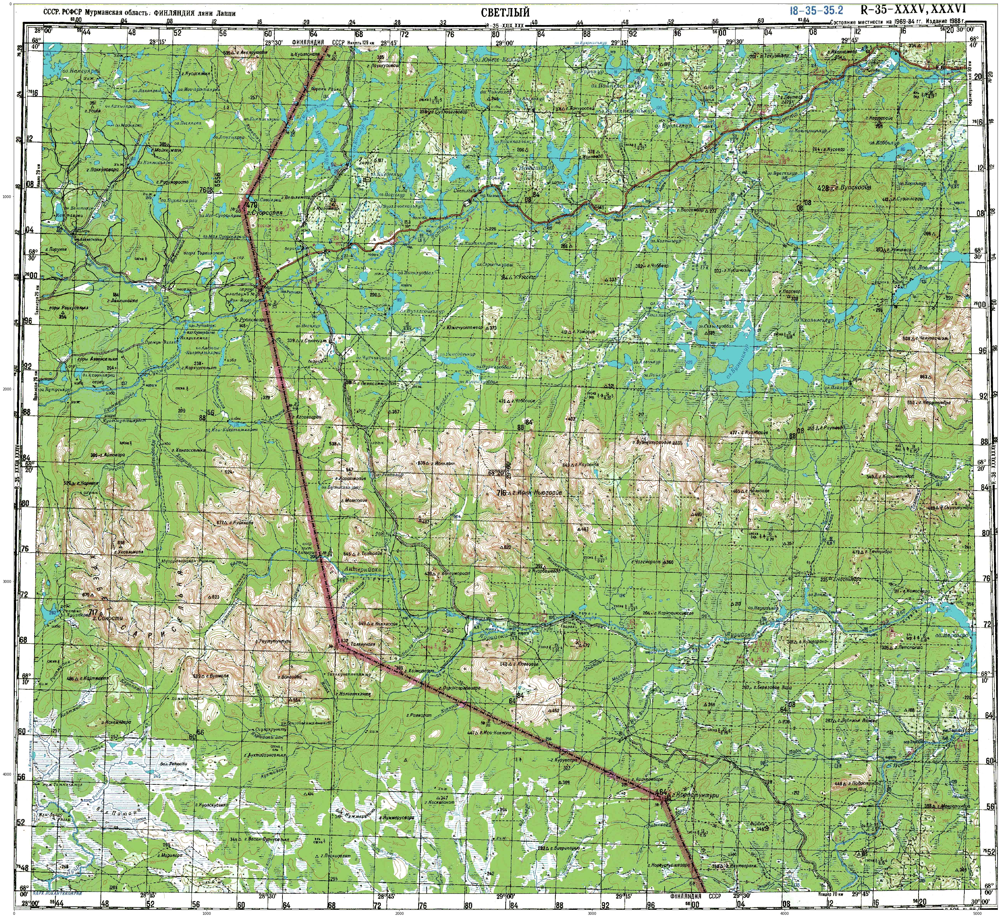

In [31]:
image = Image.open('img2.jpg')

def show_image(image):
    plt.figure(figsize=(50, 50))
    plt.imshow(image)

show_image(image)

(500, 5106, 3)

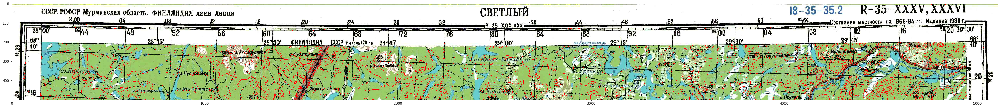

In [35]:
#Image -> np.array
#The isoline color is: [97, 136, 143]
import math

def get_color_distance(co, ct):
    return math.sqrt((co[0] - ct[0]) ** 2 + (co[1] - ct[1]) ** 2 + (co[2] - ct[2]) ** 2)

isocolor = [113, 133, 46]
image_array = np.array(image)[:500]
isoimage = image_array
display(image_array.shape)
for x in range(len(image_array)):
    for y in range(len(image_array[0])):
        if get_color_distance(image_array[x][y], isocolor) < 50:
            isoimage[x][y][0] = 255
            isoimage[x][y][1] = 0
            isoimage[x][y][2] = 0
#        else:
#            isoimage[x][y][0] = 0
#            isoimage[x][y][1] = 0
#            isoimage[x][y][2] = 0
show_image(isoimage)

In [28]:
image_array = np.array(image)
for y in range(len(image_array)):
    mean_color = np.sum(np.sum(image_array[y], axis=0) / len(image_array[y])) / 3
    for x in range(len(image_array[y])):
        image_array[y][x] = mean_color
distance_image = image_array

In [148]:
def get_outline(image, color):
    width, height = image.shape
    outline_image = np.zeros((width, height))
    for x in range(1, width - 1):
        for y in range(1, height - 1):
            if (image[x][y] == color) and (image[x - 1][y] != color or image[x][y - 1] != color or image[x + 1][y] != color or image[x][y + 1] != color):
                outline_image[x][y] = 1
            else:
                outline_image[x][y] = 0
    return outline_image
                
            

In [149]:
def create_channels(image):
    width, height = image.shape
    new_image = np.zeros((width, height, 3)).astype('int')
    for x in range(width):
        for y in range(height):
            new_image[x][y][0] = image[x][y]
            new_image[x][y][1] = image[x][y]
            new_image[x][y][2] = image[x][y]
    return new_image

In [167]:
def change_binarized_colors(image, color):
    width, height = image.shape[0:2]
    new_image = np.zeros((width, height, 3)).astype('int')
    for x in range(width):
        for y in range(height):
            if image[x][y][0] == 255 and image[x][y][1] == 255 and image[x][y][2] == 255:
                new_image[x][y][0] = color[0]
                new_image[x][y][1] = color[1]
                new_image[x][y][2] = color[2]
    return new_image    

In [165]:
def binarize_colors(image, binvalue=255):
    width, height = image.shape
    for x in range(width):
        for y in range(height):
            if image[x][y] != 0:
                image[x][y] = binvalue
    return image

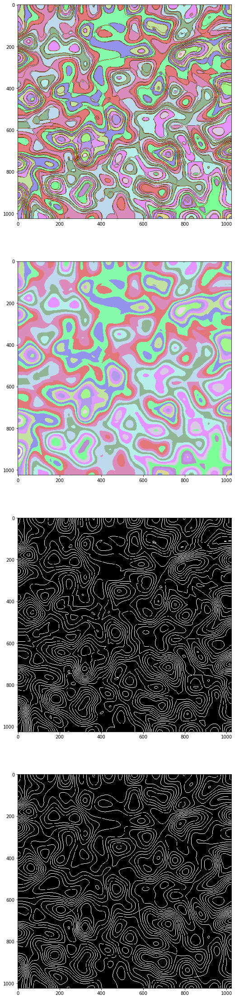

In [179]:
#How about generate custom maps (map + isoline)
from scipy.ndimage.filters import gaussian_filter
import random
#Settings
IMGW = 1024
IMGH = 1024
ISOCOLOR = [150, 75, 0]
GEOCOLOR = [75, 75, 75]

#Step 0: Generate noise
heightmap = np.random.random_sample((IMGW, IMGH))

#Step 1: Blur noise
heightmap = gaussian_filter(heightmap, 32)

#Step 2: Reduce heights count
heightmap = np.round(heightmap, 3)

#Step 3: Create isolines
isomap = np.zeros((heightmap.shape[0], heightmap.shape[1]))
for color in np.unique(heightmap):
    isomap = isomap + get_outline(heightmap, color)

#Step 5: Create geological regions map

    #Variant 1: Works enough good?
random_geomap = gaussian_filter(np.random.random_sample((IMGW, IMGH)) - np.random.random_sample((IMGW, IMGH)), 96)
heightmap = np.round(gaussian_filter(random_geomap + heightmap, 3), 3)

#Step 6: Create outlines for geolayers (It's important!!)
geomap_outlines = np.zeros((heightmap.shape[0], heightmap.shape[1]))
for color in np.unique(heightmap):
    geomap_outlines = geomap_outlines + get_outline(heightmap, color)

#Step 7: Create colors for every geolayer
geomap = np.zeros((heightmap.shape[0], heightmap.shape[1], 3)).astype('int')
for layer in np.unique(heightmap):
    layer_color = np.random.randint(120, 256, size=3)
    for x in range(0, heightmap.shape[0]):
        for y in range(0, heightmap.shape[1]):
            if heightmap[x][y] == layer:
                geomap[x][y] = layer_color
                #print(layer_color)

#Step 8: Create final isomap and outlines
binary_isomap = binarize_colors(isomap, 1)
binary_outlines = binarize_colors(geomap_outlines, 1)

#Step 8: Change layers colors to needed
topogeomap = geomap.copy()
for x in range(IMGW):
    for y in range(IMGH):
        if binary_isomap[x][y] == 1:
            topogeomap[x][y] = ISOCOLOR
        elif binary_outlines[x][y] == 1:
            topogeomap[x][y] = GEOCOLOR
              
    

#Step Optional: Visualize results
fig = plt.figure(figsize=(10, 40))
fig.add_subplot(4, 1, 1)
plt.imshow(topogeomap)
fig.add_subplot(4, 1, 2)
plt.imshow(geomap)
fig.add_subplot(4, 1, 3)
plt.imshow(create_channels(binarize_colors(geomap_outlines)))
fig.add_subplot(4, 1, 4)
plt.imshow(create_channels(binarize_colors(isomap)))

plt.savefig('fg.png')

In [146]:
#binarize_colors(isomap)

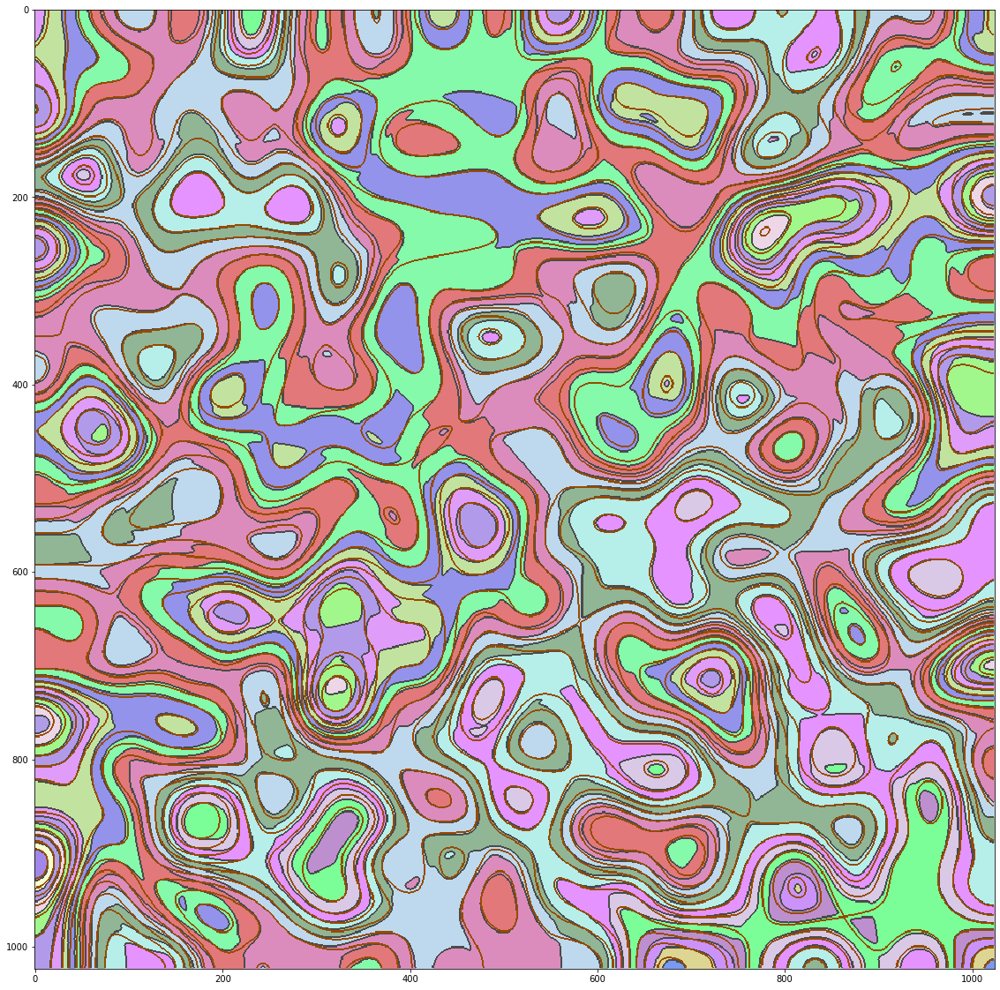

In [180]:
fig = plt.figure(figsize=(20, 20))
plt.imshow(topogeomap)